# WGANs-gp for MNIST dataset #

In [1]:
# Number of workers for training
num_workers = 4
# Batch size during training
batch_size = 512
# Spatial size of training images
image_size = 28 #64
# Number of channels in the training images. For color images this is 3. For grayscale image (e.g. MNIST) is 1.
nc = 1
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 32
# Size of feature maps in discriminator
ndf = 32
# Number of training epochs
num_epochs = 20
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5
# Beta2 hyperparam for Adam optimizers
beta2 = 0.999
# Lambda term for gradient penalty
lamb = 10.

## Step1. Lightning data module for MNIST dataset ##
MNIST data set is normalized to [-1, 1] bacause `Tanh` is used in Generator.

In [2]:
import os
import torch
from torch.utils.data import Dataset

from pytorch_lightning import LightningDataModule
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import MNIST
from torchvision import transforms
from typing import Optional


class MNISTDataset(LightningDataModule):
    def __init__(
        self,
        data_path: str,
        batch_size: int = 128,
        num_workers: int = num_workers
        ):
        super().__init__()
        self.data_dir = data_path
        self.transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5), (0.5))])
        self.batch_size = batch_size
        self.num_workers = num_workers

    def setup(self, stage: Optional[str] = None) -> None:
        if stage == 'fit' or stage is None:
            full_data = MNIST(os.getcwd(), train=True,  download=True, transform=self.transform)
            self.train_data, self.val_data = random_split(full_data, [50000, 10000])
        if stage == 'test' or stage is None:
            self.test_data  = MNIST(os.getcwd(), train=False, download=True, transform=self.transform)

    def train_dataloader(self):
        return DataLoader(self.train_data, batch_size=self.batch_size, num_workers=self.num_workers)

    def val_dataloader(self):
        return DataLoader(self.val_data, batch_size=self.batch_size, num_workers=self.num_workers)

    def test_dataloader(self):
        return DataLoader(self.test_data, batch_size=self.batch_size, num_workers=self.num_workers)        
    

## Step2. Generator and Discriminator ##

### Generator ###

In [3]:
from torch import nn

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.conv_transporse1 = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf*8, 3, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(inplace=True)
        )
        self.conv_transporse2 = nn.Sequential(
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(inplace=True)
        )
        self.conv_transporse3 = nn.Sequential(
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(inplace=True)
        )
        self.conv_transporse4 = nn.Sequential(
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(inplace=True)
        )
        self.conv_transporse5 = nn.Sequential(
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.conv_transporse1(x)
        x = self.conv_transporse2(x)
        x = self.conv_transporse3(x)
        x = self.conv_transporse4(x)
        x = self.conv_transporse5(x)
        return x

### Discriminator ###

In [4]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv2 = nn.Sequential(
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv3 = nn.Sequential(
            nn.Conv2d(ndf*2, ndf*4, 4, 1, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv4 = nn.Sequential(
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, inplace=True)
        )
        self.conv5 = nn.Sequential(
            nn.Conv2d(ndf*8, 1, 3, 1, 0, bias=False)
            #nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        x = x.view(x.shape[0], 1)
        return x

## Step3. WGANs-gp ##

In [5]:
from torch.nn import functional as F
from torch import optim
from torch import Tensor
#from torchmetrics.classification import Accuracy
from pytorch_lightning import LightningModule
from torchvision.utils import make_grid
from torchmetrics.image.fid import FrechetInceptionDistance

class WGANsGP(LightningModule):
    def __init__(
        self,
        channels: int = nc,
        width: int = image_size,
        height: int = image_size,
        latent_dim: int = nz,
        lr: float = lr,
        b1: float = beta1,
        b2: float = beta2,
        batch_size : int = 128,
        lamb: float = lamb,
        **kwargs
    ):
        super().__init__()
        self.save_hyperparameters()
        self.generator = Generator()
        self.critic = Discriminator()

        self.validation_z = torch.randn(64, self.hparams.latent_dim, 1, 1)
        self.validation_z_large = torch.randn(int(1e3), self.hparams.latent_dim, 1, 1)
        self.example_input_array = torch.zeros(2, self.hparams.latent_dim, 1, 1)
        self.generated_images = {}
        self.generated_images_large = {}
        self.generated_images_grid = {}
        self.fid = FrechetInceptionDistance(feature=64).to(self.device)
        self.automatic_optimization = False
        self.training_step_loss_G = []
        self.training_step_loss_D = []
        
    def forward(self, z):
        return self.generator(z)

    def gradient_penalty(self, real_img, fake_img):

        # Random weight term
        rnd_weights = torch.Tensor(real_img.shape).uniform_(0,1)
        rnd_weights = rnd_weights.type_as(real_img)

        # Random interpolation between real and fake
        interp = (rnd_weights * real_img + ((1 - rnd_weights) * fake_img)).requires_grad_(True)
        interp = interp.type_as(real_img)

        loss = self.critic(interp)
        fake = torch.ones(loss.shape)
        fake = fake.type_as(loss)
        gradients = torch.autograd.grad(outputs=loss, inputs=interp, grad_outputs=fake, create_graph=True, retain_graph=True)[0]
        gradients_norm = gradients.view(real_img.shape[0],-1).norm(2, dim=1)
        gradient_penalty = ((gradients_norm-1)**2).mean()

        return gradient_penalty   
    
    #def training_step(self, batch, batch_size, optimizer_idx): # Lightning < 2.0
    def training_step(self, batch, batch_size): # for Lightning >= 2.0
        images, _ =  batch

        # real images for FID. If you don't need FID metrics, please comment out.
        if self.global_step == 0:
            images_3ch = images.expand(images.size(0), 3, images.size(2), images.size(3))
            images_3ch = images_3ch[:64].type(torch.uint8).to(self.device)
            self.fid.update(images_3ch, real=True)

        # latent vector
        z = torch.randn(images.shape[0], self.hparams.latent_dim, 1, 1)
        z = z.type_as(images)


        ### Lightning >= 2.0 ###
        opt_G, opt_D = self.optimizers()
        val = torch.ones(images.shape[0], 1)
        val = val.type_as(images)

        # training the generator
        logits_G = self.critic(self(z))
        loss_G = -1. * torch.mean(logits_G)
        opt_G.zero_grad()
        self.manual_backward(loss_G)
        opt_G.step()


        # training the discriminator
        logits_real = self.critic(images)
        loss_real = -1.* torch.mean(logits_real)

        fake = torch.zeros(images.shape[0], 1)
        fake = fake.type_as(images)
        fake_images = self(z)
        logits_fake = self.critic(fake_images.detach())
        loss_fake = torch.mean(logits_fake)

        # gradient penalty
        gp = self.gradient_penalty(images, fake_images)
        loss_D = loss_real + loss_fake + gp*self.hparams.lamb
        
        opt_D.zero_grad()
        self.manual_backward(loss_D)
        opt_D.step()

        self.log('loss_G',loss_G, prog_bar=True, on_step=True)
        self.log('loss_D',loss_D, prog_bar=True, on_step=True)
        self.training_step_loss_G.append(loss_G)
        self.training_step_loss_D.append(loss_D)

        return None
    
        #log = {'train_loss_G': loss_G}
        #return {'loss': loss_G, 'logs': log}


        ### Lightning < 2.0 ###
        '''
        # training the generator
        if optimizer_idx == 0:
            val = torch.ones(images.shape[0], 1)
            val = val.type_as(images)
            logits_G = self.critic(self(z))
            loss_G = -1. * torch.mean(logits_G)

            log = {'train_loss_G': loss_G}
            return {'loss': loss_G, 'logs': log}

        # training the discriminator
        if optimizer_idx == 1:
            val = torch.ones(images.shape[0], 1)
            val = val.type_as(images)
            logits_real = self.critic(images)
            loss_real = -1.* torch.mean(logits_real)

            fake = torch.zeros(images.shape[0], 1)
            fake = fake.type_as(images)
            fake_images = self(z)
            logits_fake = self.critic(fake_images.detach())
            loss_fake = torch.mean(logits_fake)

            # gradient penalty
            gp = self.gradient_penalty(images, fake_images)
            loss_D = loss_real + loss_fake + gp*self.hparams.lamb

            log = {'train_loss_D': loss_D}
            return {'loss': loss_D, 'logs': log}
        '''

    def configure_optimizers(self):
        lr = self.hparams.lr
        b1 = self.hparams.b1
        b2 = self.hparams.b2
        
        opt_G = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(b1,b2))
        opt_D = torch.optim.Adam(self.critic.parameters(), lr=lr, betas=(b1,b2))

        #return [opt_G, opt_D], [] # Lightning < 2.0
        return opt_G, opt_D # Lightning >= 2.0

    def on_train_epoch_end(self) -> None:
        training_epoch_loss_G = torch.stack(self.training_step_loss_G).mean()
        training_epoch_loss_D = torch.stack(self.training_step_loss_D).mean()
        self.training_step_loss_G.clear()
        self.training_step_loss_D.clear()
        self.log('epoch_loss_G', training_epoch_loss_G, prog_bar=True, on_epoch=True)
        self.log('epoch_loss_D', training_epoch_loss_D, prog_bar=True, on_epoch=True)

        # fake images in a grid
        z = self.validation_z.to(self.device)
        sample_images = self(z)
        grid = make_grid(sample_images, nrow=8)
        self.logger.experiment.add_image('generated images', grid, self.current_epoch)
        self.generated_images[self.current_epoch] = sample_images
        self.generated_images_grid[self.current_epoch] = grid

        # fake images
        z_large = self.validation_z_large.to(self.device)
        sample_images_large = self(z_large)
        self.generated_images_large[self.current_epoch] = sample_images_large

        # FID. If you don't need FID metrics, please comment out.
        sample_images_3ch = sample_images.expand(sample_images.size(0), 3, sample_images.size(2), sample_images.size(3)).type(torch.uint8).to(self.device)
        self.fid.update(sample_images_3ch, real=False)
        fid_metrics = self.fid.compute().item()
        self.log('FID', fid_metrics, prog_bar=True, on_epoch=True)


## Step4. Logger ##

In [6]:
from pytorch_lightning.loggers import TensorBoardLogger

logger = TensorBoardLogger(save_dir='./tb_logs/', name = 'WGANs-gp_light')


%reload_ext tensorboard
%tensorboard --logdir=./tb_logs/

## Step5. Build & fit model ##

In [7]:
data = MNISTDataset(data_path = './', batch_size=batch_size)
model = WGANsGP()

In [8]:
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks.progress import TQDMProgressBar

runner = Trainer(max_epochs=num_epochs,
                 #gpus=[0], # comment out if you use 'cpu.
                 accelerator='gpu',  # 'cpu' or 'gpu', 'auto'
                 logger=logger, 
                 callbacks=[TQDMProgressBar(refresh_rate=10)])


runner.fit(model, data)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/hep/shayashi/.pyenv/versions/3.8.6/lib/python3.8/site-packages/pytorch_lightning/trainer/configuration_validator.py:70: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type                     | Params | In sizes       | Out sizes     
-----------------------------------------------------------------------------------------
0 | generator | Generator                | 920 K  | [2, 100, 1, 1] | [2, 1, 28, 28]
1 | critic    | Discriminator            | 691 K  | ?              | ?             
2 | fid       | FrechetInceptionDistance | 23.9 M | ?              | ?             
------------------------------------------------------

Epoch 19: 100%|██████████| 98/98 [00:11<00:00,  8.20it/s, v_num=18, loss_G=19.50, loss_D=-.406, epoch_loss_G=19.00, epoch_loss_D=-.326, FID=66.50]  

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 19: 100%|██████████| 98/98 [00:14<00:00,  6.58it/s, v_num=18, loss_G=19.50, loss_D=-.406, epoch_loss_G=19.00, epoch_loss_D=-.326, FID=66.50]


## Step6. Check fake images ##

### Fake images ###

(20, 242, 242)



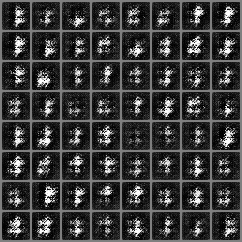
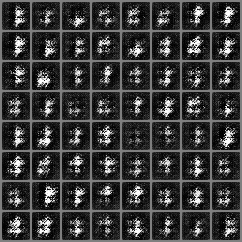
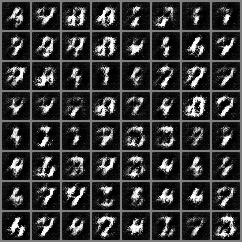
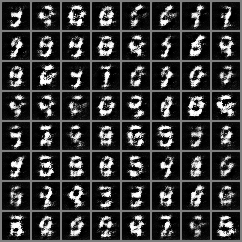
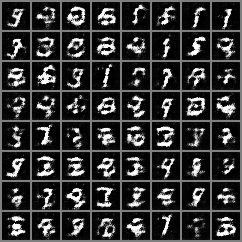
...
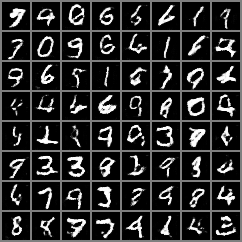
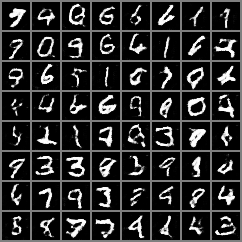
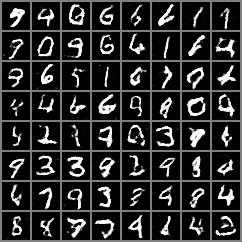
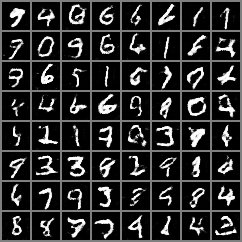
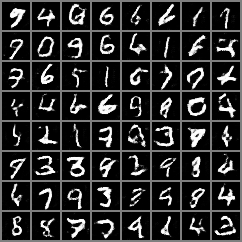

In [9]:
import numpy as np
import plotly.express as px

fake_images_grid = model.generated_images_grid

imgs = np.array([fake_images_grid[i][0].to(torch.device('cpu')).numpy() for i in fake_images_grid])
print(imgs.shape)

fig = px.imshow(imgs, animation_frame=0, binary_string=True)
fig.update_layout(
    autosize=False, 
    width=600, 
    height=800,
    sliders=[{
    "currentvalue": {
        "font": {"size": 14},
        "prefix": "Epoch:",
        "visible": True,
        "xanchor": "left"
    }
    }])

fig.show()

### t-SNE (Real images) ###

In [10]:
from sklearn.manifold import TSNE
import pandas as pd
import numpy as np

tsne = TSNE(n_components=2, random_state=0)



mnist_tmp = MNIST(os.getcwd(), 
                  train=False, 
                  download=True, 
                  transform=transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5), (0.5))])
                  )


real_mnist_data = np.array([mnist_tmp[i][0].numpy() for i in range(10000)])
#real_mnist_data = mnist_tmp.data.numpy()
real_mnist_data = real_mnist_data.reshape(real_mnist_data.shape[0],-1)
real_mnist_label = mnist_tmp.test_labels.numpy().reshape(-1,1).astype(dtype=str)

tsne_real_mnist = tsne.fit_transform(real_mnist_data)
print(tsne_real_mnist.shape)
df_tsne_real_mnist = pd.concat([pd.DataFrame(real_mnist_label), pd.DataFrame(tsne_real_mnist)], axis=1)
df_tsne_real_mnist.columns = ['label', 'component 1', 'component 2']

/home/hep/shayashi/.pyenv/versions/3.8.6/lib/python3.8/site-packages/torchvision/datasets/mnist.py:70: UserWarning:

test_labels has been renamed targets



(10000, 2)


In [11]:
label_order = [str(i) for i in range(10)]
colors = px.colors.qualitative.Plotly

fig = px.scatter(data_frame = df_tsne_real_mnist, x='component 1', y='component 2', color='label', color_discrete_sequence=colors, category_orders={'label':label_order})

fig.update_layout(title='t-SNE, Real MNIST', width=800, height=800)
fig.show()

### t-SNE (Real+Fake images) ###

In [12]:
fake_images_large = model.generated_images_large

fake_mnist_data = np.array([fake_images_large[i].to(torch.device('cpu')).detach().numpy() for i in fake_images_large])
fake_mnist_data = fake_mnist_data.reshape(fake_mnist_data.shape[0], fake_mnist_data.shape[1], -1)

In [13]:
df_tsne_fake_mnist = pd.DataFrame([])

for i in range(fake_mnist_data.shape[0]):
    print('epoch', i)
    real_fake_data = np.concatenate([real_mnist_data, fake_mnist_data[i]], axis=0)
    real_fake_label = np.concatenate([real_mnist_label, np.full((fake_mnist_data[i].shape[0],1), 'fake')], axis=0)

    tsne_real_fake_mnist = tsne.fit_transform(real_fake_data)

    epoch = np.full((tsne_real_fake_mnist.shape[0], 1), str(i))
    df_tmp = pd.concat([pd.DataFrame(epoch), pd.DataFrame(real_fake_label), pd.DataFrame(tsne_real_fake_mnist)], axis=1)

    df_tsne_fake_mnist = pd.concat([df_tsne_fake_mnist, df_tmp], axis=0)

df_tsne_fake_mnist.columns = ['Epoch', 'label', 'component 1', 'component 2']

epoch 0
epoch 1
epoch 2
epoch 3
epoch 4
epoch 5
epoch 6
epoch 7
epoch 8
epoch 9
epoch 10
epoch 11
epoch 12
epoch 13
epoch 14
epoch 15
epoch 16
epoch 17
epoch 18
epoch 19


In [14]:
label_order.append('fake')
colors.append('black')
fig = px.scatter(data_frame = df_tsne_fake_mnist, x='component 1', y='component 2', animation_frame='Epoch', color='label', color_discrete_sequence=colors, category_orders={'label':label_order})

fig.update_layout(title='t-SNE, Real+Fake MNIST', width=800, height=800)
fig.show()

### Histogram of values in the image ###

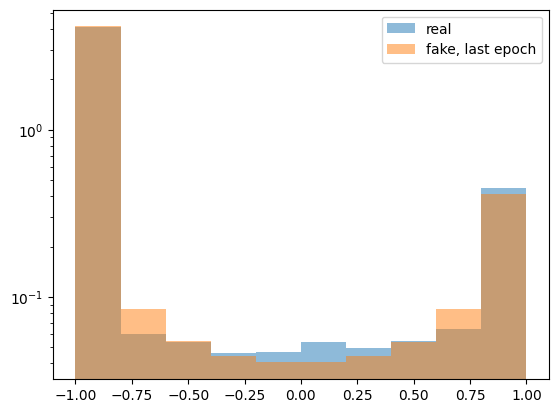

In [15]:
import matplotlib.pyplot as plt
plt.hist(real_mnist_data.flatten(), density=True, alpha=0.5, label='real')
plt.hist(fake_mnist_data[-1].flatten(), density=True, alpha=0.5, label='fake, last epoch')
plt.yscale('log')
plt.legend()
plt.show()